# LAB1 - Computer vision
***Brice Tayart***

## Part I: denoising a binary image

The noise consists in randomly inverted pixels without any spatial consistency. Such noise should be well suited to denoising by median filtering.

Several filters are tested. Each time, the denoised image and the difference are displayed:
- 4-neighbors filter: much of the noise have disapeared, but some noisy spots remain where several contiguous pixels had been inverted.
- 4-neighbors filter, 2 pass: a second pass of denoising with the same filter removes more noisy spots, but the larger groups of noisy pixels remain. The first *a* on the top row is affected by the filter, some of the letter has disappeared where it was thin.
- 8-neighbors filter: better than 4-neighbors, but 6-7 noisy spots remain.
- 8-neighbors filter, 2 pass: the noise has been completely eliminated.
- 5x5 filter: the noise is completem eliminated. However, on can see on the second *a* and on the *d* on the second row, that some background white has been blackened where there were sharp reentrant angles.
- 2-radius disk filter: noise has been completemy eliminated



In [1]:
import numpy as np
from skimage import io
from skimage import filters
import matplotlib.pyplot as plt

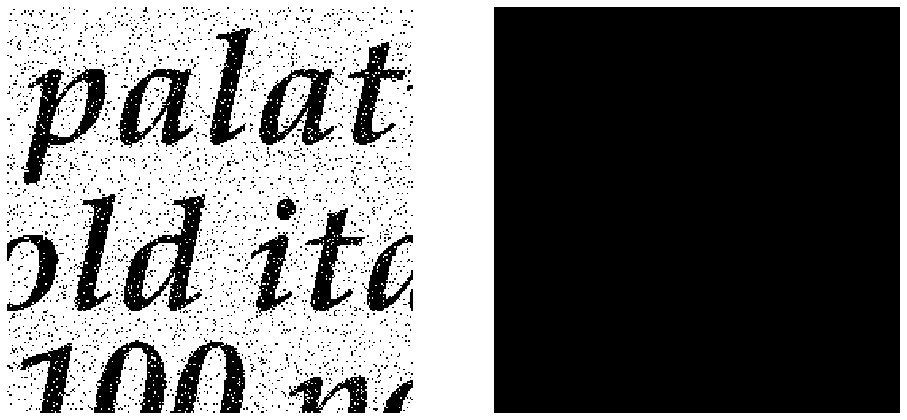

In [2]:
img = io.imread("texte_bruit.gif")


def show_img(image, circ=None, circ2=None):
    """display an image, the difference with img and
    circles centered on useful details"""
    def plot_circle(C):
        if C is not None:
            for xctr, yctr in C:
                circle = [(xctr + 10*np.cos(ang),
                           yctr + 10*np.sin(ang))
                          for ang in np.linspace(0, 2*np.pi, 20)]
                x, y = zip(*circle)
                plt.plot(x, y, '-r')

    plt.figure(figsize=(16, 8))
    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    plot_circle(circ)

    plt.subplot(1, 2, 2)
    plt.imshow(image-img.astype(int), cmap='gray')
    plt.axis('off')
    plot_circle(circ2)


show_img(img)

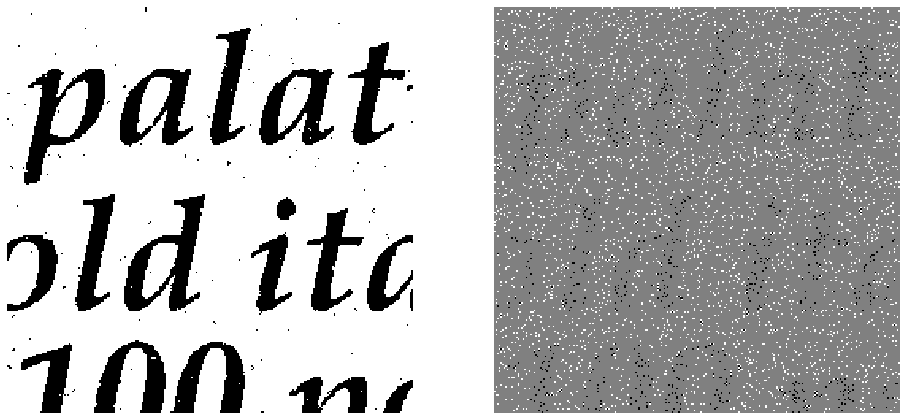

In [3]:
# Median filtering over 4 neighbors
filt_4n = np.array([[0, 1, 0], [1, 1, 1], [0, 1, 0]], dtype=int)
show_img(filters.median(img, filt_4n))

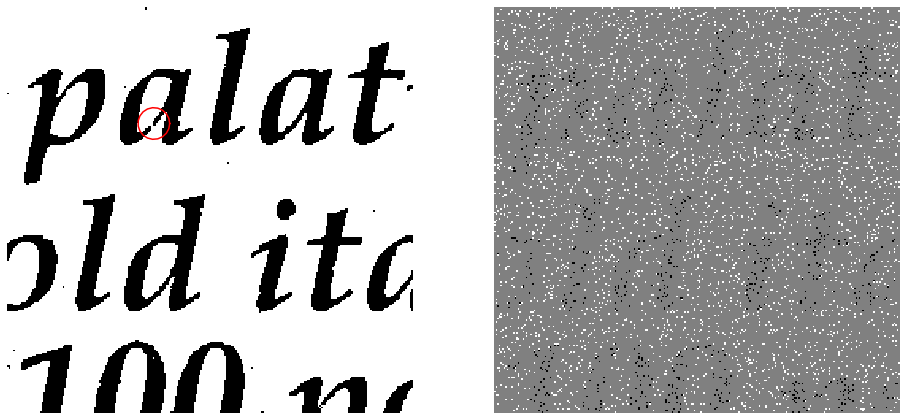

In [4]:
# Median filtering over 4 neighbors, 2 passes
show_img(filters.median(
    filters.median(img, filt_4n),
    filt_4n), circ=[(92, 73)])

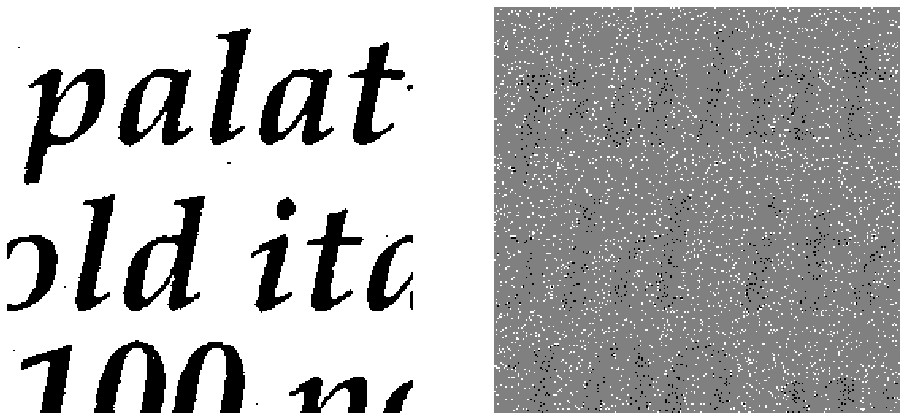

In [5]:
# Median filtering over 8 neighbors
filt_8n = np.ones((3, 3), dtype=int)
show_img(filters.median(img, filt_8n))

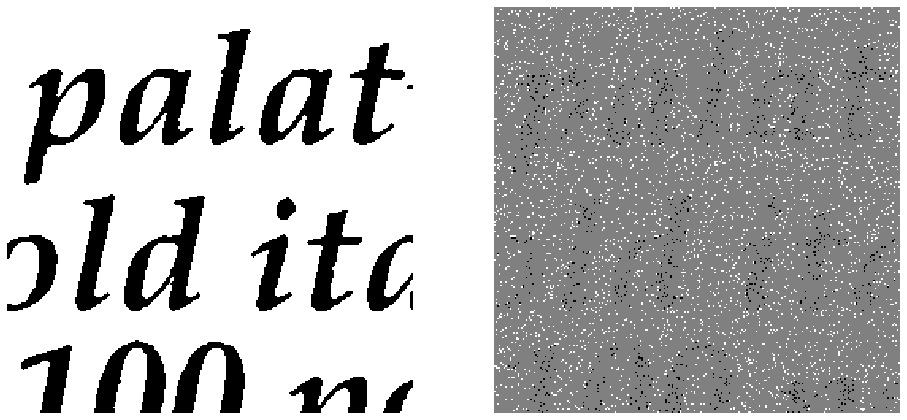

In [6]:
# Median filtering over 8 neighbors, 2 passes
show_img(filters.median(
    filters.median(img, filt_8n),
    filt_8n))

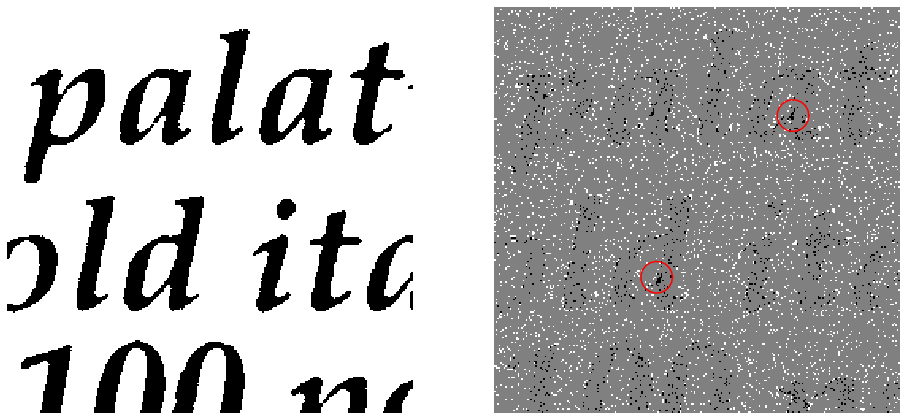

In [7]:
# 5x5 median filter
filt_5x5 = np.ones((5, 5), dtype=int)
show_img(filters.median(img, filt_5x5),
         circ2=[(102, 170), (188, 68)])

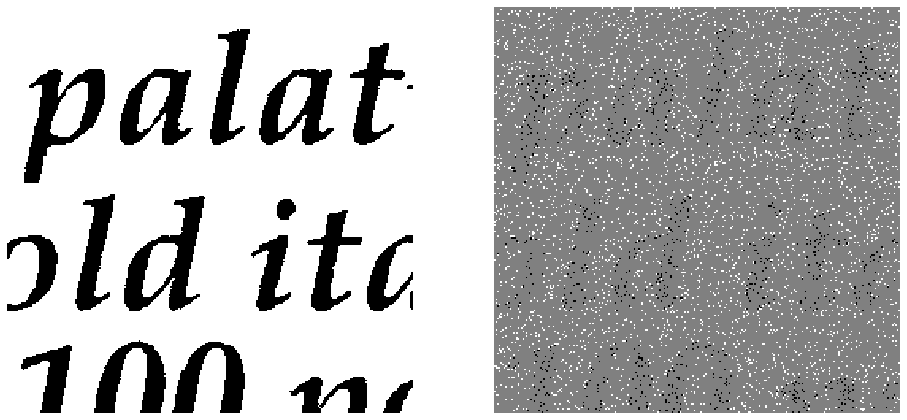

In [8]:
# filter over 12 nearby pixels
filt_wide = np.array([
    [0, 0, 1, 0, 0],
    [0, 1, 1, 1, 0],
    [1, 1, 1, 1, 1],
    [0, 1, 1, 1, 0],
    [0, 0, 1, 0, 0],
], dtype=int)
show_img(filters.median(img, filt_wide))

In [9]:
io.imsave("texte_sans_bruit.gif", filters.median(img, filt_wide))

## Partie 2:  scikit-image tutorials
### a) Watershed segmentation
https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_watershed.html  
The method from the *scikit-image* tutorial above is applied to a grey-scale image of a plane (rather than just copy-pasting the code and run it on synthetic data).
Processing sequence is as folllows: the image is read, converted to greyscale. The gradient is computed with Sobel filters and watershed segmenttion is done using local minima of the gradient as markers.

First, the image is laoded and displayed.

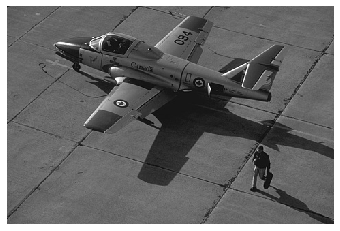

In [15]:
from scipy import ndimage as ndi

from skimage import segmentation
from skimage.segmentation import watershed
from skimage.feature import peak_local_max
from skimage.color import label2rgb, rgb2gray

#img = io.imread('37073_HR.png').mean(axis=2,dtype=np.int32)
img = (rgb2gray(io.imread('37073_HR.png'))*255).astype(np.int32)

plt.imshow(img, cmap="gray", vmin=0, vmax=255)
plt.axis("off")

The next step is the gradient calculation. Since this is a grayscale image with a single channel, there is no hard choice to do there.

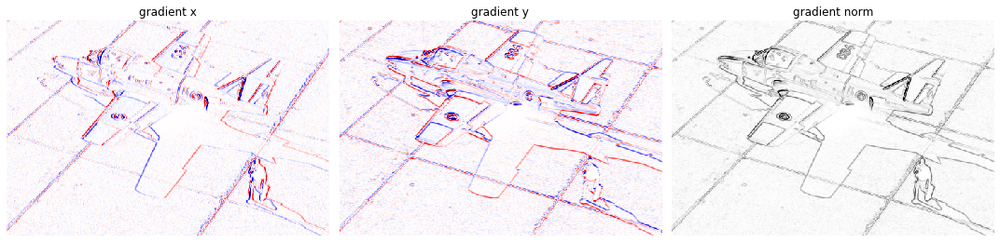

In [16]:
grad_x = ndi.sobel(img, axis=1)
grad_y = ndi.sobel(img, axis=0)
grad_sum = np.sqrt(grad_x**2 + grad_y**2)
lim = 800

f, axes = plt.subplots(ncols=3, figsize=(15, 5), sharex=True, sharey=True)
ax = axes.ravel()
ax[0].imshow(grad_x, cmap="seismic", vmin=-lim, vmax=lim)
ax[0].set_title("gradient x")
ax[1].imshow(grad_y, cmap="seismic", vmin=-lim, vmax=lim)
ax[1].set_title("gradient y")
ax[2].imshow(grad_sum, cmap="binary", vmin=0, vmax=lim)
ax[2].set_title("gradient norm")
for a in ax:
    a.set_axis_off()
f.tight_layout()

Visually, one can see that the gradient generally shows the contours of the plane and other objects quite well. There are some exceptions, such as the wing on the foreground progressively merging into the shadow under the plane, resulting in a very dim gradient.

**Calculating and displaying markers**: Next step is to find local minima that will become merkers for the waershed.

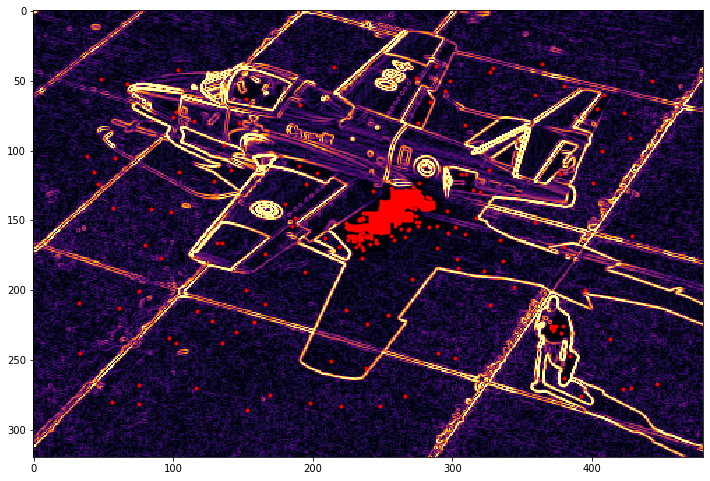

In [17]:
local_maxi = peak_local_max(-grad_sum, min_distance=30, indices=False)
plt.figure(figsize=(12, 9))
plt.imshow(grad_sum, cmap="inferno", vmin=0, vmax=250)
plt.plot(*reversed(np.where(local_maxi)), '.r')

The `peak_local_max` function used in the tutorial selects all pixels when the local maximum is a plateau rather than a peak. Also, there is a `min_distance` option that does not work well when local maxima have the same value. This happens often on the image as the gradient is equal to zero at few places. To correct this and avoid having a bunch of markers under the place, a slight continuous bias of a magnitude much lower than one bit in the original image is introduced, for the sole purpose of breaking equalities.

Nombre de marqueurs :  56


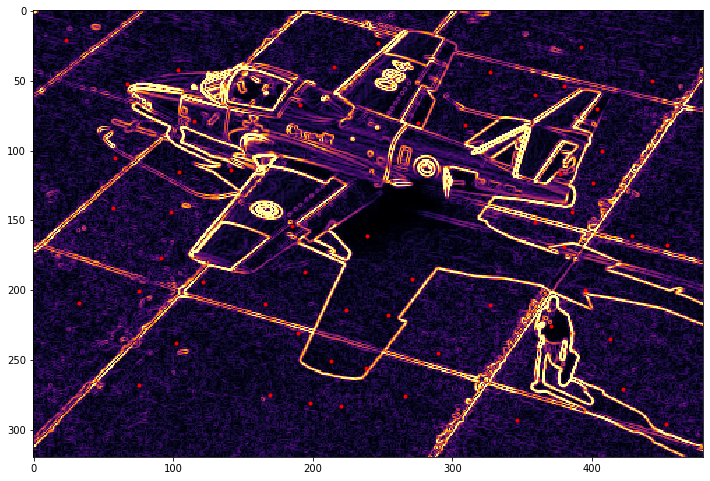

In [18]:
# Ajout d'un biais faible
h, w = img.shape
extra = (np.linspace(-1, 1, h).reshape(-1, 1)**2 +
         np.linspace(-1, 1, w).reshape(1, -1)**2)*1e-6

local_maxi = peak_local_max(-grad_sum-extra, min_distance=20, indices=False)
plt.figure(figsize=(12, 9))
plt.imshow(grad_sum+extra, cmap="inferno", vmin=0, vmax=250)
plt.plot(*reversed(np.where(local_maxi)), '.r')
print("Nombre de marqueurs : ", local_maxi.sum())

Finally, the watershed algorithm is applied to segment the image.

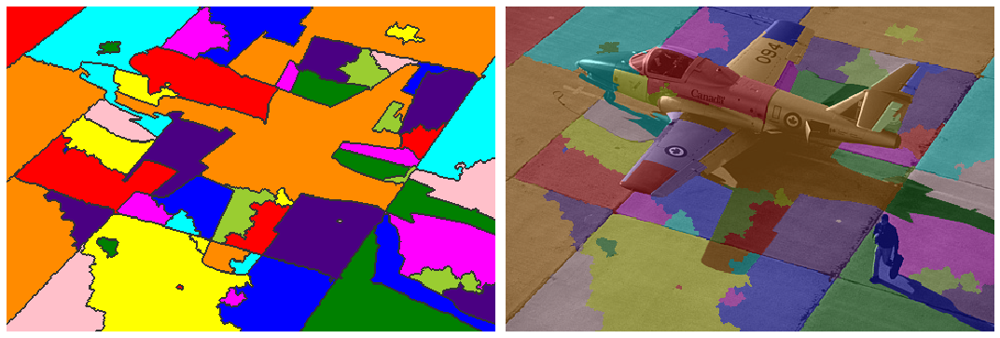

In [19]:
markers = ndi.label(local_maxi)[0]
labels = watershed(grad_sum, markers)

f, axes = plt.subplots(ncols=2, figsize=(15, 7), sharex=True, sharey=True)
ax = axes.ravel()
disp_img = label2rgb(labels, bg_label=0)
disp_img[segmentation.find_boundaries(labels)] = .2
ax[0].imshow(disp_img)
ax[1].imshow(label2rgb(labels, img.astype(np.single)/255, bg_label=0))
for a in ax:
    a.set_axis_off()
f.tight_layout()

**Conclusion**: the image is over segmented. The contours of the plane and pedestrian are globally well detected. Concrete slabs on the ground are split into several segments, sometime very small. Where the luminance is quite uniform, slight fluctuations in the level of gray will create local minima, spawning several markers - and segments - in those uniform areas.

### b) Initializing markers in areas where the gradient is under a threshold
https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_marked_watershed.html#sphx-glr-auto-examples-segmentation-plot-marked-watershed-py 

This time, all pixels for which the gradient is under a threshold are selected. Hopefully, this will allow these uniform areas to be selected as a whole and avoid over-segmentation.

To compute these initial markers, another gradient is used: the difference between the largest and smallest greyscale level over a smell disk centered around the pixel. Using a wide disk (with radius of 5 pixels) somewhat smears the borders. There is less chance that some noise locally lowers the gradient of a border below the threshold and lets two segments communicate and be merged.

The initialization of markers is done with several thresholds and disk radius.

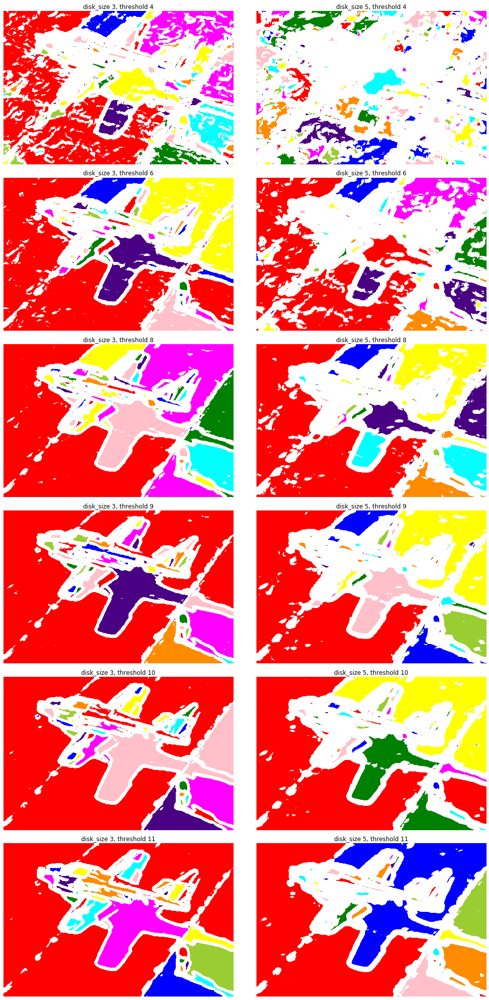

In [21]:
from skimage.morphology import disk
from skimage.filters import rank

denoised = rank.median(img.astype(np.uint8), disk(5))

f, axs = plt.subplots(nrows=6, ncols=2, sharex=True,
                      sharey=True, figsize=(15, 28))
for jj, grad_disk in enumerate([3, 5]):
    smooth_gradient = rank.gradient(denoised, disk(grad_disk))
    for ii, threshold in enumerate([4, 6, 8, 9, 10, 11]):
        markers = ndi.label(smooth_gradient < threshold)[0]
        axs[ii, jj].imshow(label2rgb(markers, bg_label=0, bg_color=[1, 1, 1]))
        axs[ii, jj].set_title("disk_size %d, threshold %d" %
                              (grad_disk, threshold))
for a in axs.ravel():
    a.set_axis_off()
f.tight_layout()

Lowering the threshold tends to framgent uniform areas in smaller parts. However, if a threshold is too high, some borders may be missed (e.g. the limits between slabs). Likewise, a larger disks helps segmenting (we see that with *threshold=11*, several slabs are identifies with a larger disk and only one with the smaller disk). But small marker areas may also disappear, especially thin ones.

We can also see that some marker areas are extremely small; a handful of pixels.

Segmentation is now done with *disk size = 4* and *threshold = 11*.

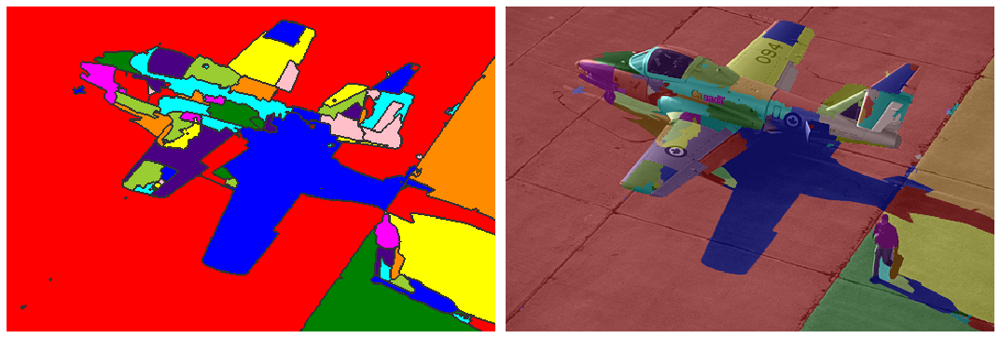

In [22]:
grad_disk = 4
threshold = 11

smooth_gradient = rank.gradient(denoised, disk(grad_disk))
markers = ndi.label(smooth_gradient < threshold)[0]
labels = watershed(grad_sum, markers)

f, axes = plt.subplots(ncols=2, figsize=(15, 7), sharex=True, sharey=True)
ax = axes.ravel()

disp_img = label2rgb(labels, bg_label=0)
disp_img[segmentation.find_boundaries(labels)] = .2
ax[0].imshow(disp_img)

ax[1].imshow(label2rgb(labels, img.astype(float)/255, bg_label=0))
for a in ax:
    a.set_axis_off()
f.tight_layout()

The plane has been cut in a large number of segments, some extremenly small. This shows how watershed tends to cause over-segmentation if the markers are not very carefully chosen.

In order to alleviate this issue, segments with an area smaller than some threshold are deleted. A second pass of watershed is done from the remaining labels.

In [23]:
def remove_small_areas(img_labels, img_gradient, threshold):
    """
    Remove labels with a small count and cycle through watershed.
    threshold: minimum number of pixels to keep the label
    """
    small_labels = [v for v, c in zip(
        *np.unique(img_labels, return_counts=True)) if c < threshold]
    img_labels = img_labels.copy()
    img_labels[np.isin(img_labels, small_labels)] = 0
    new_labels = watershed(img_gradient, img_labels)
    return new_labels

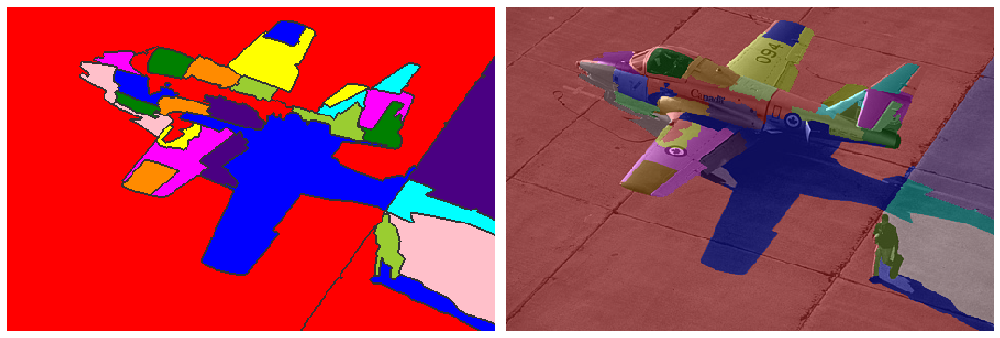

In [24]:
pix_threshold = 400

# Suppression des segments trop petits
labels = watershed(grad_sum, markers)
labels = remove_small_areas(labels, grad_sum, pix_threshold)

f, axes = plt.subplots(ncols=2, figsize=(15, 7), sharex=True, sharey=True)
ax = axes.ravel()
disp_img = label2rgb(labels, bg_label=0)
disp_img[segmentation.find_boundaries(labels)] = .2
ax[0].imshow(disp_img)
ax[1].imshow(label2rgb(labels, img.astype(float)/255, bg_label=0))
for a in ax:
    a.set_axis_off()
f.tight_layout()

This is a bit better. There are less segments in the plane. There is single segment for the pedestrian and another for its shadow, rather than separate ones for the torse, legs, bag, shadow on each side of the slab joint...

Another possibility would be to remove small marker areas immediately after the thresholding, before the watershed algorithm is used.

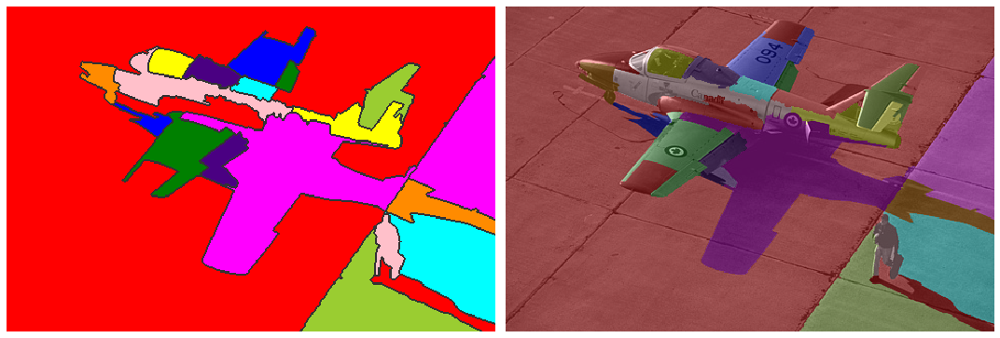

In [25]:
pix_threshold = 100

# Suppression des segments trop petits

labels = remove_small_areas(markers, grad_sum, pix_threshold)

f, axes = plt.subplots(ncols=2, figsize=(15, 7), sharex=True, sharey=True)
ax = axes.ravel()
disp_img = label2rgb(labels, bg_label=0)
disp_img[segmentation.find_boundaries(labels)] = .2
ax[0].imshow(disp_img)
ax[1].imshow(label2rgb(labels, img.astype(float)/255, bg_label=0))
for a in ax:
    a.set_axis_off()
f.tight_layout()

This results in even less segments, perhaps too few: the painted panels at the tips of the wings are now merged into the concrete ground.

### c) Compact watershed
https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_compact_watershed.html#sphx-glr-auto-examples-segmentation-plot-compact-watershed-py

Finally, a last option is to initialize markers on a regular grid and apply the conpact watershed algorithm that favors compact segments. This is done using *compactness* parameter on a log scale between 0.001 and 10, as well as no compactness.

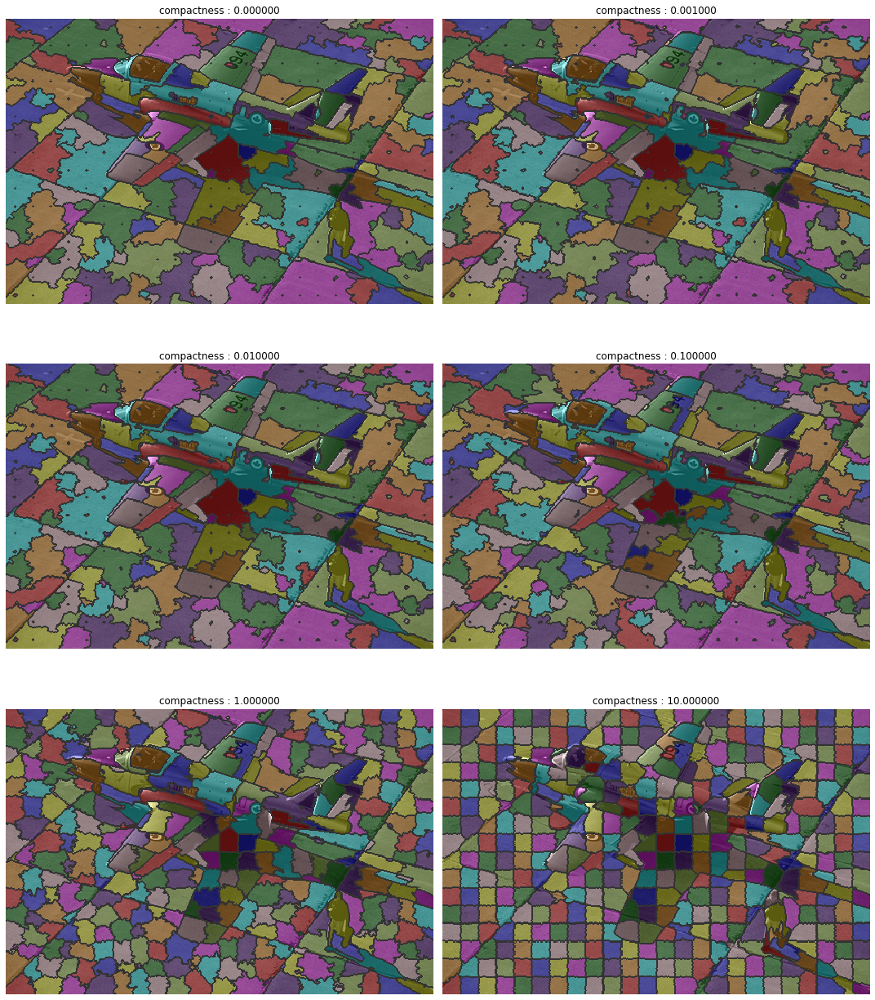

In [26]:
from skimage import util
grid = util.regular_grid(img.shape, 384)

seeds = np.zeros(img.shape, dtype=int)
seeds[grid] = np.arange(seeds[grid].size).reshape(seeds[grid].shape) + 1

f, axs = plt.subplots(3, 2, sharex=True, sharey=True, figsize=(15, 18))
for ii, (comp, ax) in enumerate(zip([0.0, 0.001, 0.01, 0.1, 1, 10], axs.ravel())):
    labels = watershed(grad_sum, seeds, compactness=comp)
    disp_img = label2rgb(labels, img/255, bg_label=0)
    disp_img[segmentation.find_boundaries(labels)] = .2
    ax.imshow(disp_img)
    ax.set_axis_off()
    ax.set_title("compactness : %f" % comp)
f.tight_layout()

Applying the *compact watershed* from a regular grid. If the compactness high, the segmentation tends to yield an extremely regular grid. When it is low, some areas will be extremely small (e.g. if a marker was near a peak of the gradient).

In order to remove these tiny segment the following method is tried: a morphological erosion is performed on the segments (or rather, the borders between segments are extracted and expanded by a morphological dilation, and the labels are reset in this area close to borders). A second pass of watershed is applied. This should eliminate small segments, especially thin ones.


In [27]:
from skimage import morphology


def erode_labels(labels, gradient, disk_size=8, **kwargs):
    boundaries = segmentation.find_boundaries(labels)
    boundaries = morphology.binary_dilation(
        boundaries, morphology.disk(disk_size))
    labels[boundaries] = 0
    labels = watershed(gradient, labels, **kwargs)
    return labels

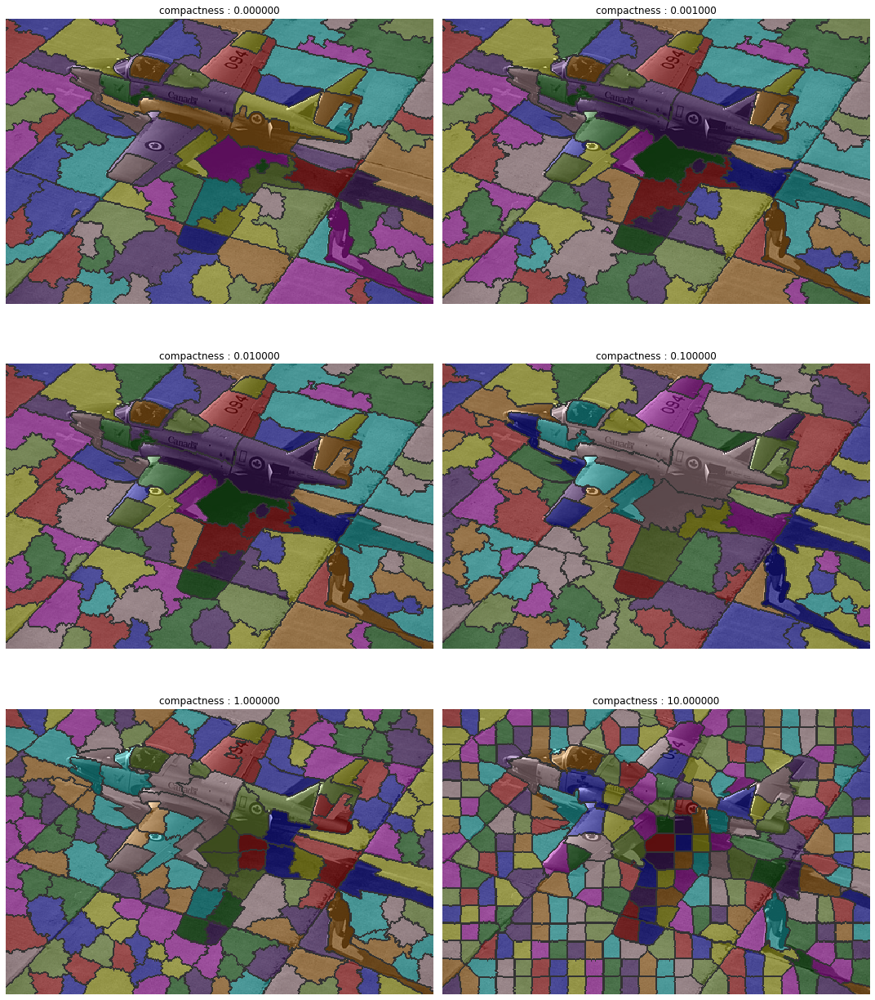

In [28]:
disk_size = 8

f, axs = plt.subplots(3, 2, sharex=True, sharey=True, figsize=(15, 18))
for ii, (comp, ax) in enumerate(zip([0.0, 0.001, 0.01, 0.1, 1, 10], axs.ravel())):
    labels = watershed(grad_sum, seeds, compactness=comp)
    labels = erode_labels(labels, grad_sum, disk_size, compactness=comp)

    boundaries = segmentation.find_boundaries(labels)
    disp_img = label2rgb(labels, img/255, bg_label=0)
    disp_img[boundaries] = .2
    ax.imshow(disp_img)
    ax.set_axis_off()
    ax.set_title("compactness : %f" % comp)
f.tight_layout()

The result has over-segmentation, as expected with a regular grid of inital markers, but tiny segments have been eliminated.

Instead of an erosion, small segments can also be eliminated with a threshold on their area. While erosion tended to elimnate this segments, the area threshold eliminates small ones regardless of their shape.

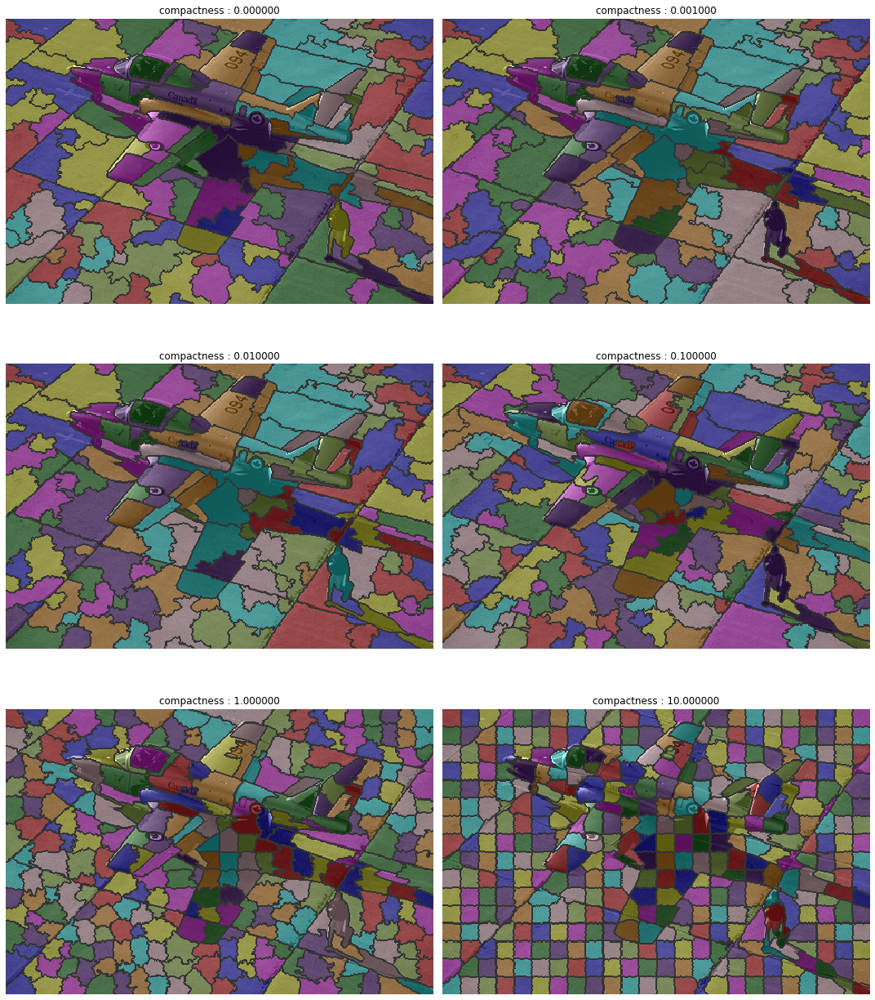

In [29]:
pix_threshold = 150

f, axs = plt.subplots(3, 2, sharex=True, sharey=True, figsize=(15, 18))
for ii, (comp, ax) in enumerate(zip([0.0, 0.001, 0.01, 0.1, 1, 10], axs.ravel())):
    labels = watershed(grad_sum, seeds, compactness=comp)

    labels = remove_small_areas(labels, grad_sum, pix_threshold)

    boundaries = segmentation.find_boundaries(labels)
    disp_img = label2rgb(labels, img/255, bg_label=0)
    disp_img[boundaries] = .2
    ax.imshow(disp_img)
    ax.set_axis_off()
    ax.set_title("compactness : %f" % comp)
f.tight_layout()

Both methods yield similar results. Erosion probably removed more segments, but this a matter of setting parameters (disk size for erosion or area threshold) rather than some essential properties of these methods. 

Finally, we take one of this segmentations and apply it on the original, color image. The pixels in each segments are replaced by the average pixel of the segment. Hey, this looks like a Photoshop filter!

In [34]:
def compress_image(image, labels):
    """Replace pixels in each segment by the average pixel"""
    imgout = np.zeros(image.shape)
    for ll in np.unique(labels[:]):
        imgout[labels == ll] = imgcolor[labels == ll].mean(axis=0)/255
    return imgout

(-0.5, 479.5, 319.5, -0.5)

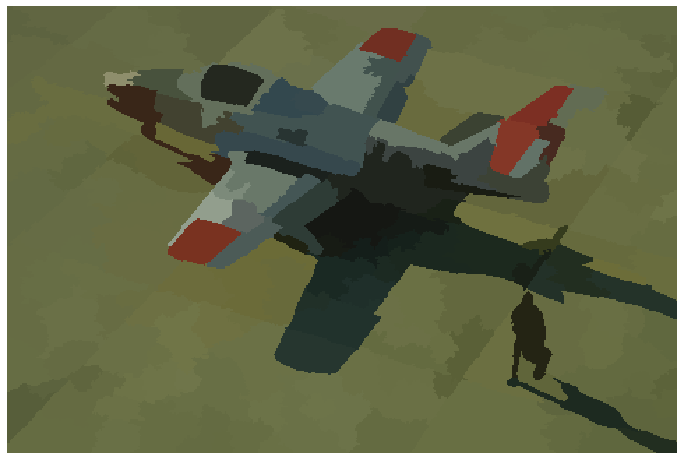

In [35]:
imgcolor = io.imread('37073_HR.png').astype(np.single)

labels = watershed(grad_sum, seeds, compactness=.1)
labels = remove_small_areas(labels, grad_sum, pix_threshold)


plt.figure(figsize=(12, 9))
plt.imshow(compress_image(imgcolor/255, labels), cmap="gray")
plt.axis("off")

## Partie 3:  Segmentation

In this part, several methods are used in order to segment four color images.

### a) Morphological gradient

These are color images, so the first point is: how to account for several channels in the gradient? For that, a morphological gradient in an LSH space where the gradients in luminance and hue are weighted byt the saturation, according to *J. Angulo and J. Serra, **Modelling and Segmentation of Colour Images in Polar Representations**, Image Vision and Computing 25 (2007), no. 4, 475-495*

The formula is as follows::
$ \varrho^{LS+H}(\mathbf{f(x)}) = f_S(x) \times \varrho^{\circ}(f_H(x)) + (1-f_S(x)) \times \varrho(f_L(x)) + \varrho(f_S(x))$ where $\varrho(f(x))$ is the morphological gradient, $\varrho^\circ$ is the centered circular gradient and $f_L$, $f_S$ and $f_H$ the luminance, saturation and hue channels respectively.

The inividual gradient for each channel and the composite weighted gradient are shown below for one of the pictures.

In [38]:
from skimage.color import rgb2hsv, hsv2rgb


def rgb2lsh(image):
    L = image.mean(axis=2, dtype=np.single)/255
    H = rgb2hsv(image)[:, :, 0].astype(np.single)

    R, G, B = np.moveaxis(image.astype(np.single)/255, 2, 0)
    S = .25*(np.abs(2*R-G-B) + np.abs(2*G-R-B) + np.abs(2*B-R-G))
    return L, S, H


def morph_grad(field, selem=None):
    if selem is None:
        selem = ndi.morphology.generate_binary_structure(field.ndim, 1)
    return ndi.morphology.morphological_gradient(field, footprint=selem)


def circular_distance(a1, a2):
    delta = np.abs(a1-a2)
    delta[delta > .5] = 1.-delta[delta > .5]
    return 2*delta


def circle_grad(field, selem=None):
    ndim = field.ndim
    if selem is None:
        selem = ndi.morphology.generate_binary_structure(ndim, 1)
    s = selem.shape[0]
    shift = np.arange(selem.shape[0])-s//2

    all_indices = np.unravel_index(np.arange(selem.size), selem.shape)
    output = np.zeros(field.shape)

    dims_ = tuple(range(ndim))
    for idx in zip(*all_indices):
        if not selem[idx]:
            continue
        shifted_field = np.roll(field, idx, dims_)
        shifted_distance = circular_distance(field, shifted_field)
        # remove invalid (wrapped around) values
        for d in dims_:
            bad_slice = [None for _ in dims_]
            if idx[d] == 0:
                continue
            elif idx[d] < 0:
                bad_slice[d] = slice(idx[d], None)
            else:
                bad_slice[d] = slice(None, idx[d])
            shifted_distance[tuple(bad_slice)] = 0
        output = np.maximum(output, shifted_distance)
    return output


def composite_grad(L, S, H, selem=None):
    return S*circle_grad(H, selem) + (1-S)*morph_grad(L, selem) + morph_grad(S, selem)


image_files = ["3096_HR.png", "37073_HR.png", "66053_HR.png", "101087_HR.png"]

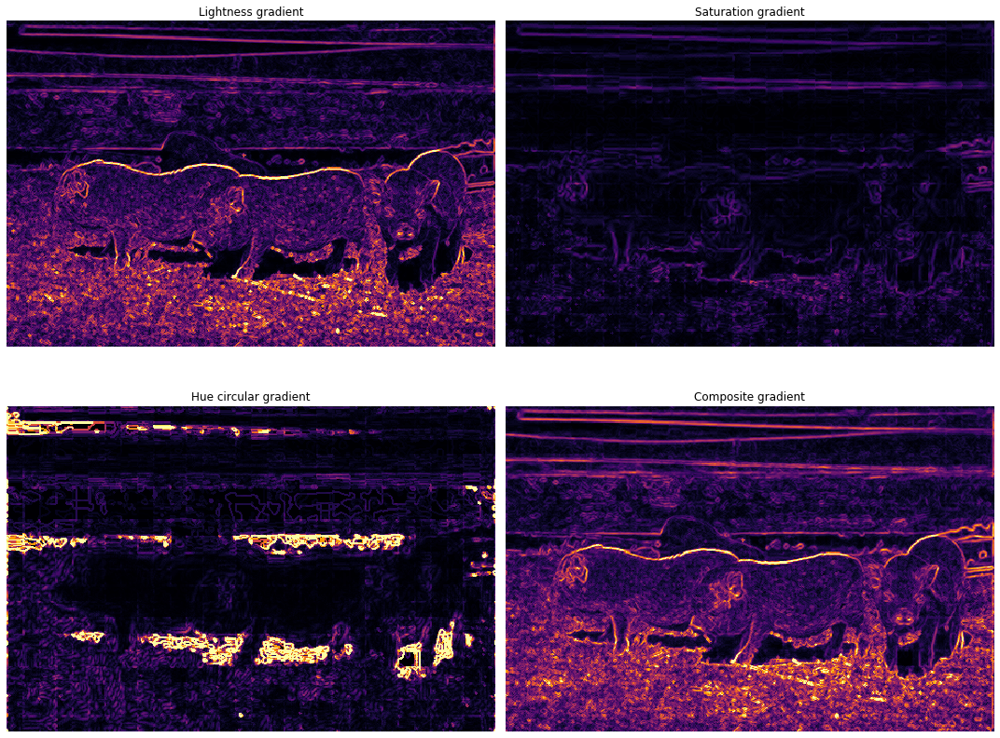

In [39]:
L, S, H = rgb2lsh(io.imread(image_files[2]))

f, axs = plt.subplots(2, 2, figsize=(15, 12))
axs = axs.ravel()

axs[0].imshow(morph_grad(L), cmap="inferno", vmax=.5)
axs[0].set_title("Lightness gradient")

axs[1].imshow(morph_grad(S), cmap="inferno", vmax=.5)
axs[1].set_title("Saturation gradient")

axs[2].imshow(circle_grad(H), cmap="inferno", vmax=.5)
axs[2].set_title("Hue circular gradient")

axs[3].imshow(composite_grad(L, S, H), cmap="inferno", vmax=.5)
axs[3].set_title("Composite gradient")

for ax in axs:
    ax.set_axis_off()
f.tight_layout()

### b) Segmentation

The method from **2.b)** is used: initialize markers where the gradient is under a threshold, then apply watershed. Several variants are tested below.

The gradient and initial markers are displayed on the left side, and the final segmentation on the right side.

#### i. Watershed + removal of small semgents
The processing is as follows:
- Initialize markers by thresholding the gradient
- Propagate them to the whole picture with a watershed
- Remove segments having an area under a threshold
- Propagate again

In [53]:
from skimage import segmentation
from skimage.color import label2rgb

from matplotlib import cm
from matplotlib.colors import ListedColormap

ncolors = 2048
# custom colormap
map_arr = cm.get_cmap("gist_rainbow", ncolors)(np.linspace(0, 1, ncolors))*.5 +\
    cm.get_cmap("prism", ncolors)(np.linspace(0, 1, ncolors))*.5
custom_map = ListedColormap(map_arr.copy())
map_arr[0, :] = 1.0
custom_map_w = ListedColormap(map_arr.copy())


def show_grad_and_seeds(ax, gradient, seeds):
    ax.imshow(gradient, cmap="binary", vmax=.5)
    ax.imshow(seeds, alpha=.5, cmap=custom_map_w)
    ax.set_axis_off()


def show_segmentation(ax, labels, image):
    boundaries = segmentation.find_boundaries(labels)
    disp_img = label2rgb(labels, image, bg_label=0)
    disp_img[boundaries] = .7
    ax.imshow(disp_img)
    ax.set_axis_off()
    return disp_img

/home/btayart/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:277: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 4. + (arr[idx, 0] - arr[idx, 1]) / delta[idx]


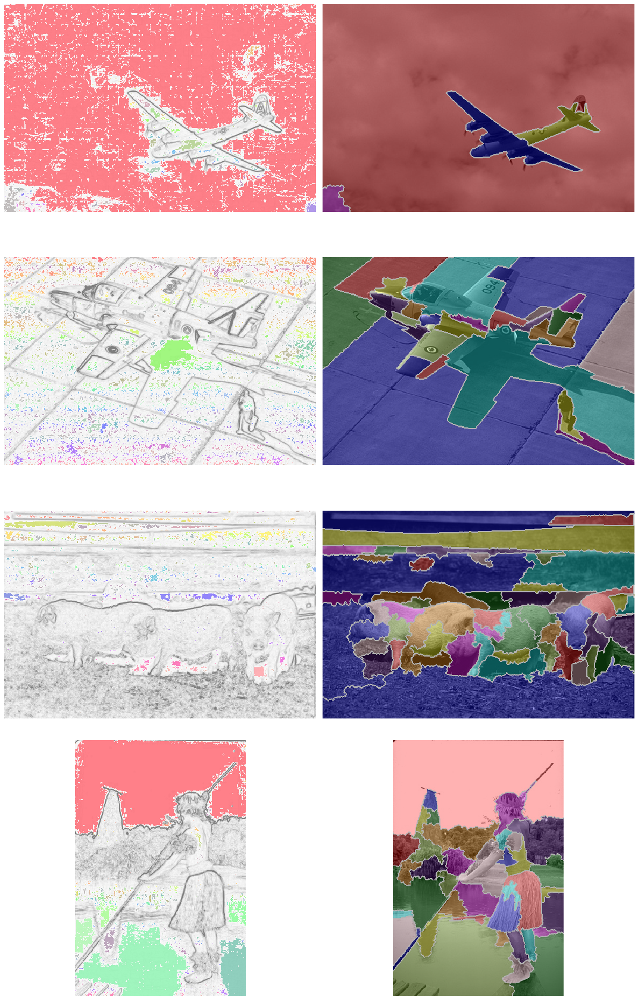

In [41]:
f, axs = plt.subplots(4, 2, figsize=(15, 24))
grad_threshold = .020
pix_threshold = 400

for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    #seeds = ndi.label(gradient < grad_threshold)[0]
    seeds = ndi.label(gradient < grad_threshold, np.ones((3, 3), dtype=int))[0]
    show_grad_and_seeds(ax[0], gradient, seeds)

    labels = watershed(gradient, seeds)
    labels = remove_small_areas(labels, gradient, pix_threshold)
    show_segmentation(ax[1], labels, image)

f.tight_layout()

#### ii. Remove small markers + watershed
This time, markers that cover a smell area are removed upfront, then a watershed is applied:
- Initialize markers by thresholding the gradient
- Remove markers having an area under a threshold
- Propagate them to the whole picture with a watershed

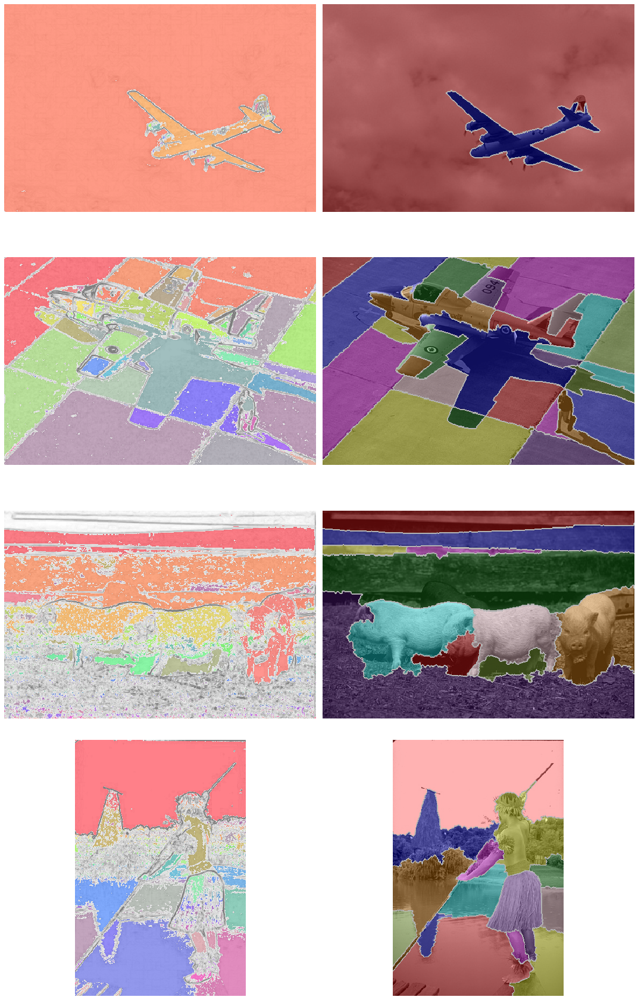

In [44]:
f, axs = plt.subplots(4, 2, figsize=(15, 24))
grad_threshold = .08
pix_threshold = 400
for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    seeds = ndi.label(gradient < grad_threshold)[0]
    show_grad_and_seeds(ax[0], gradient, seeds)

    labels = remove_small_areas(seeds, gradient, pix_threshold)

    show_segmentation(ax[1], labels, image)

f.tight_layout()

#### iii. Initialize with aux. gradient + Remove small markers + watershed
This is the same as **ii.**, but another gradient is used for the initialization. That one is calculated with a larger disk. For the watershed, the gradient is the same.
- Initialize markers by thresholding the **auxiliary** gradient
- Remove markers having an area under a threshold
- Propagate them to the whole picture with a watershed

What is difficult is to set the initial threshold. If it is too high, a part of the image will be covered with markers, which resulst in over-segmentation. Increasing the minimal size of markers may help to alleviate this. If it is too low, large uniform parts of the image may start to become fragmented (such as the sky in the first image of plane). This also leads to over-segmentation.  

There, the choice was made to use a high threshold, but also to keep only initial markers with a large area.

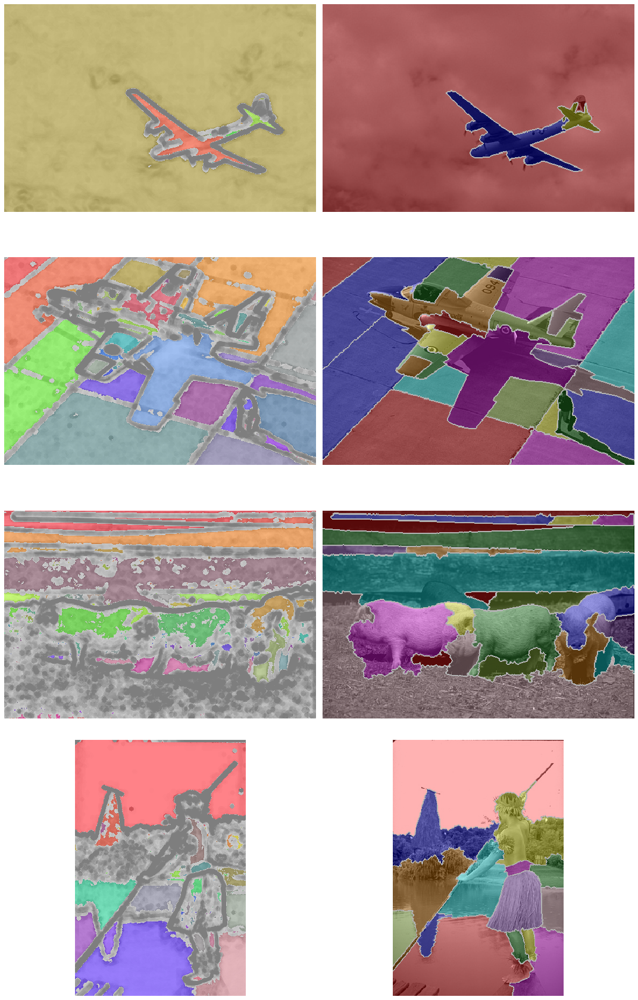

In [66]:
f, axs = plt.subplots(4, 2, figsize=(15, 24))
grad_threshold = .20
pix_threshold = 150
selem = disk(4)
for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    gradient_smoothed = composite_grad(*rgb2lsh(image), selem)
    seeds = ndi.label(gradient_smoothed < grad_threshold)[0]
    show_grad_and_seeds(ax[0], gradient_smoothed, seeds)

    labels = remove_small_areas(seeds, gradient, pix_threshold)
    img_save = show_segmentation(ax[1], labels, image)

    img_save = (img_save*255).astype(np.uint8)
    seg = segmentation.find_boundaries(labels)
    image[seg] = np.array([255, 0, 0], dtype=np.uint8)
    io.imsave("watershed_a_"+im, img_save)
    io.imsave("watershed_b_"+im, image)


f.tight_layout()

#### iv. Initialize with aux. gradient + Watershed + removal of small semgents
Finally, the initialization with aux gradient (as in **iii.**) is tried with the small segments removed after the watershed (as in **i.**).
The processing is as follows:
- Initialize markers by thresholding the **auxiliary** gradient
- Propagate them to the whole picture with a watershed
- Remove segments having an area under a threshold
- Propagate again

This yields more over-segmentation than **iii.**


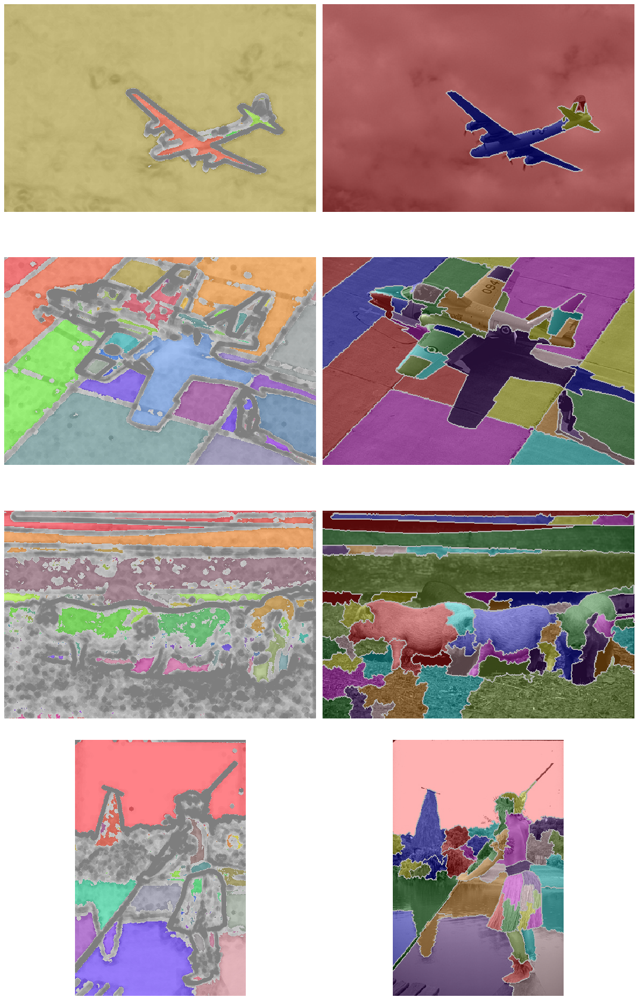

In [46]:
f, axs = plt.subplots(4, 2, figsize=(15, 24))
grad_threshold = .20
pix_threshold = 400
selem = disk(4)
for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    gradient_smoothed = composite_grad(*rgb2lsh(image), selem)
    seeds = ndi.label(gradient_smoothed < grad_threshold)[0]

    show_grad_and_seeds(ax[0], gradient_smoothed, seeds)

    labels = watershed(gradient, seeds)
    labels = remove_small_areas(labels, gradient, pix_threshold)

    show_segmentation(ax[1], labels, image)

f.tight_layout()

#### Conclusion
Method **iii.** seems to give the best results across images. The corresponding images were saved as ***watershed_a_xxxx_HR.png*** with segmentation highlighted by colors and ***watershed_b_xxxx_HR.png*** with borders set to red.
La méthode semble donner les meilleurs résultats pour les trois images.

Ce qui n'a pas été testé: on peut probablement réussir à limiter la sur-segmentation en regroupant des segments pour lesquels la valeur du gradient lorsqu'il se touchent est faible (l'$altitude du col* entre les vallées est petite). Il faudrait pour cela une segmentation hiérarchique, et notamment enregistrer au cours du watershed l'altitude des contacts

### c) Hierarchical segmentation
The over-segmentation problem can probably be alleviated by merging segments when the gradient on the border that separates them is low. A way to do this is the hierarchical segmention.

It is initalized with a *compact watershed* on a regular grid, in order to get small segments homogeneously spread across the image. A loop on the border between segments is used to build a graph of connected segments, each edge being labeled with the lowest value of the gradient on the corresponding border. The graph is pruned into a minimum spanning tree, and the $K-1$ remaining edges with the larges label are deleted in order to get $K$ contiguous subgraphs.

In [67]:
import time
from scipy.sparse.csgraph import minimum_spanning_tree, connected_components
from scipy.sparse import coo_matrix


def compact_watershed(gradient, compactness, disk_size):
    """ Run a compact watershed, erode small segments and do 2nd pass"""
    grid = util.regular_grid(image.shape[:2], 384)

    seeds = np.zeros(image.shape[:2], dtype=int)
    seeds[grid] = np.arange(seeds[grid].size).reshape(seeds[grid].shape) + 1

    labels = watershed(gradient, seeds, compactness=.005)
    labels = erode_labels(labels, gradient, 8, compactness=.005)
    return labels


def compact_labels(labels):
    """remove holes in the label numbering (inplace) - keep 0 for background"""
    unique_labels = np.unique(labels)
    for ii, l in enumerate(sorted(unique_labels)):
        labels[labels == l] = ii+1
    print("Number of labels: ", labels.max())


def build_ms_tree(labels, gradient):
    compact_labels(labels)
    boundaries = list(zip(*np.where(segmentation.find_boundaries(labels))))
    print(len(boundaries), "boundary pixels")

    # compute edges (slow-ish)
    edges = {}
    t0 = time.time()
    for px, py in boundaries:
        label = labels[px, py]
        alt = gradient[px, py]
        for next_pix in [(px+1, py), (px, py+1)]:
            if next_pix in boundaries:
                label2 = labels[next_pix]

                # Add 1: if gradient is zero, edge doesn't count in adjacency matrix
                alt_join = 1.0 + max(gradient[next_pix], alt)
                key = tuple(sorted([label, label2]))
                edges[key] = min(alt_join, edges.get(key, np.inf))
    t1 = time.time()
    print("Edge computing done in %.1fs" % (t1-t0))

    # Remove loops
    edges = {(i, j): v for (i, j), v in edges.items() if i != j}

    # Throw all into a sparse matrix and let scipy get the tree
    I, J, V = zip(*[(i-1, j-1, v) for (i, j), v in edges.items()])
    adjacency_matrix = coo_matrix((V, (I, J)),
                                  shape=(labels.max(), labels.max()))
    tree = minimum_spanning_tree(adjacency_matrix)
    return tree


def segment_tree(labels, tree, K):
    """ Cut K highes values edges in the tree and return new labels """
    n_edges = (tree.data != 0).sum()

    tree_copy = tree.copy()
    ind = np.argpartition(tree_copy.data, n_edges+1-K)
    tree_copy.data[ind[n_edges+1-K:]] = 0
    tree_copy.eliminate_zeros()
    n, tree_labels = connected_components(
        tree_copy, directed=False, return_labels=True)

    new_labels = 1+tree_labels[labels-1]
    return new_labels

This is applied to the *fisherman* (?) picture. The image shows the initia segmentation from the *compact wtershed* and the result after splitting the image into $K$ segments, with K = 10, 20 or 40.

Number of labels:  257
23530 boundary pixels
Edge computing done in 21.3s


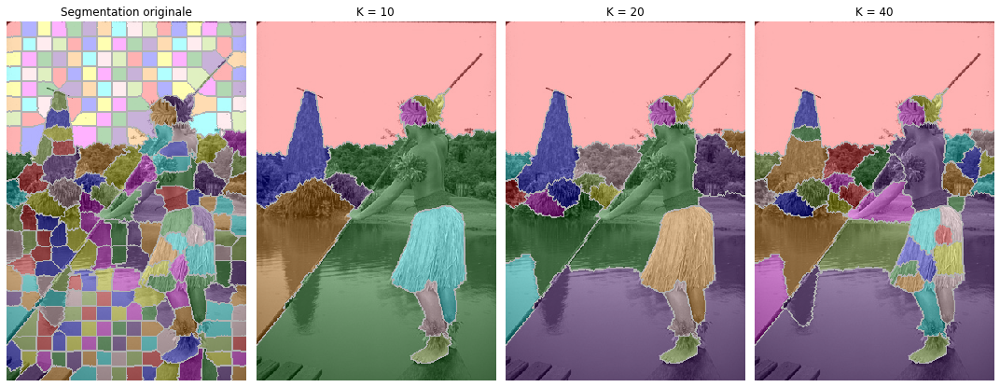

In [68]:
f, axs = plt.subplots(1, 4, figsize=(15, 6))

image = io.imread(image_files[3])
gradient = composite_grad(*rgb2lsh(image))

labels = compact_watershed(gradient, .005, 8)
show_segmentation(axs[0],  labels, image)
axs[0].set_title("Segmentation originale")

tree = build_ms_tree(labels, gradient)
for ii, K in enumerate([10, 20, 40]):
    new_labels = segment_tree(labels, tree, K)
    show_segmentation(axs[ii+1], new_labels, image)
    axs[ii+1].set_title("K = %d" % K)

f.tight_layout()

The result is also shown for the three other pictures.

Number of labels:  354
26512 boundary pixels
Edge computing done in 26.1s
Number of labels:  246
22870 boundary pixels
Edge computing done in 20.6s
Number of labels:  192
22460 boundary pixels
Edge computing done in 19.0s


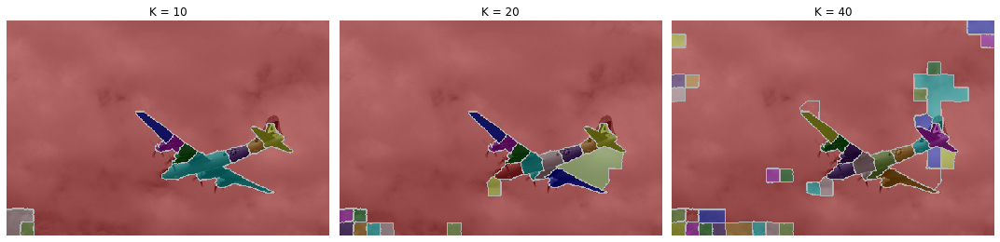

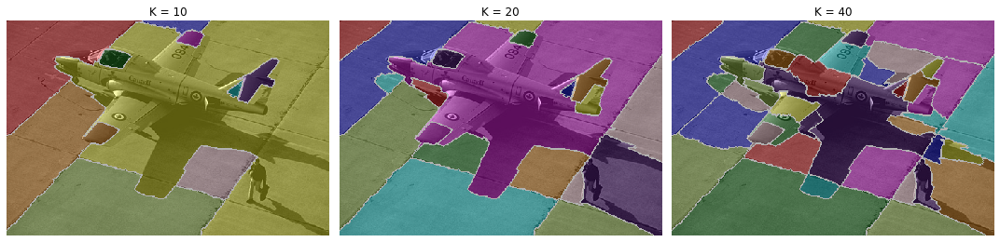

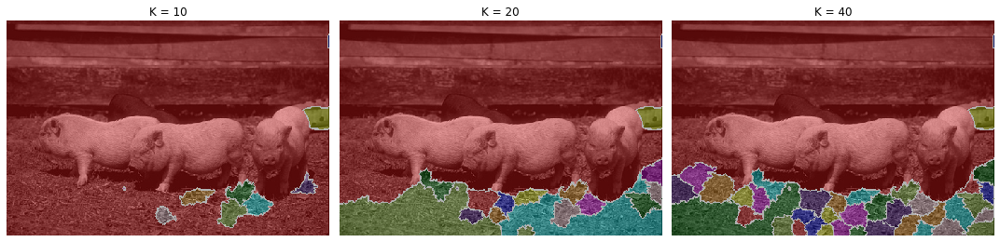

In [69]:
for ii in range(3):
    f, axs = plt.subplots(1, 3, figsize=(15, 5))

    image = io.imread(image_files[ii])
    gradient = composite_grad(*rgb2lsh(image))

    labels = compact_watershed(gradient, .005, 8)

    tree = build_ms_tree(labels, gradient)
    for ii, K in enumerate([10, 20, 40]):
        new_labels = segment_tree(labels, tree, K)
        show_segmentation(axs[ii], new_labels, image)
        axs[ii].set_title("K = %d" % K)

    f.tight_layout()

### Conclusion

- First difficulty is the choice of $K$. The image of the *flying plane* may be split into 2 segments only. Adding some more may give a finer segmentation of the plane, but it will soon end segmenting the sky for no good reason. On the other hand, the *landed plane* or the *fisherman* will require many more segments.

- Another issue comes from clutterd parts of the picture. The *pig* image segmentation is terrible. Indeed, there is an area at the bottom of the picture where the gradient is large everywhere. Segments in this area will tend to be separated by large gradients. Hence, edges of the graph there have large labels. When pruning the tree, these segments become isolated although that segmentation has little relevance.

To alleviate this issue, a different calculation of the edge weight is needed. Perhaps the gradient at the border is not a good choice. The difference between the gradient and the average or median grandient in the surrounding segments may be a better choice (i.e. when we consider the altitude of the pass that separate watersheds, we do not condider the altitude above the sea but how high it is with respect to surrounding basins).

Another option is to repace the gradient with something better suited. Which leads to the next part:

### d) Stochastic watershed
#### I. Border count
In the following part, the gradient is replaced with a border count obtained by the stochastic watershed algorithm: a watershed is performed several times with randomly initialized markers, and we count how many time across simulations each pixel has belonged to a segment border.

Below is the comparison between the initial gradient and the border count, for each picture.

In [72]:
def stochastic_watershed(gradient, niter, nseeds):
    borders = np.zeros(gradient.shape, dtype=np.uint8)

    for _ in range(niter):
        seeds = np.zeros(gradient.shape, dtype=bool)
        seeds.flat[np.random.choice(
            gradient.size, nseeds, replace=False)] = True
        seeds = ndi.label(seeds)[0]
        labels = watershed(gradient, seeds)
        borders[segmentation.find_boundaries(labels)] += 1

    return borders.astype(np.single)/niter

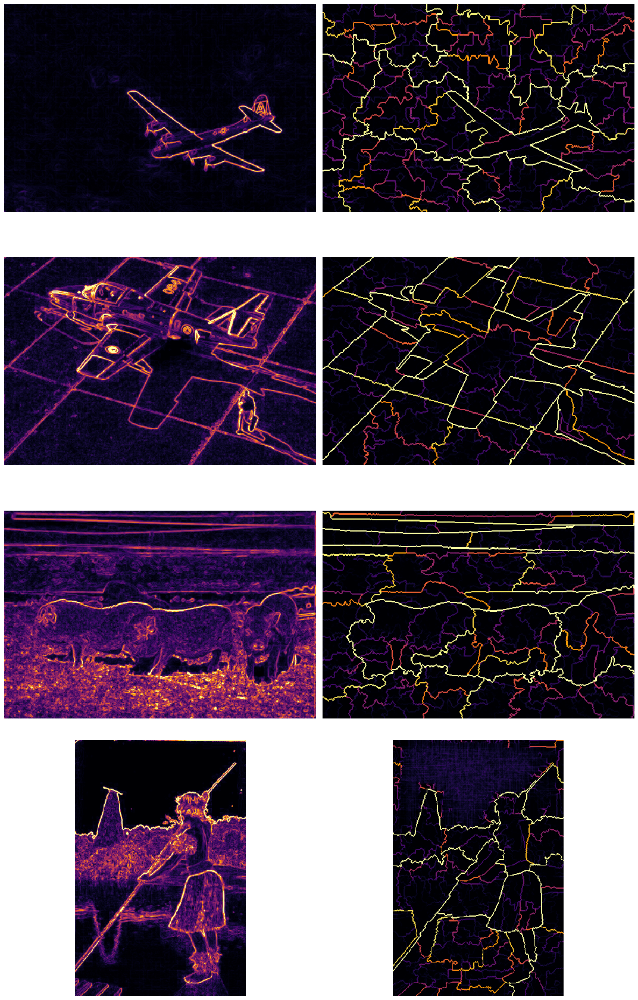

In [73]:
niter = 100
nseeds = 100

f, axs = plt.subplots(4, 2, figsize=(15, 24))

for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    borders = stochastic_watershed(gradient, niter, nseeds)

    ax[0].imshow(gradient, cmap="inferno",  vmax=.5)
    ax[1].imshow(borders, cmap="inferno", vmin=0, vmax=1.0)

for ax in axs.ravel():
    ax.set_axis_off()
f.tight_layout()

#### ii. Threshold based marker initialization
Here, initialization of markers from a threshold is used. The gradient, however, is replaced by the border count extracted from the stochastic watershed.

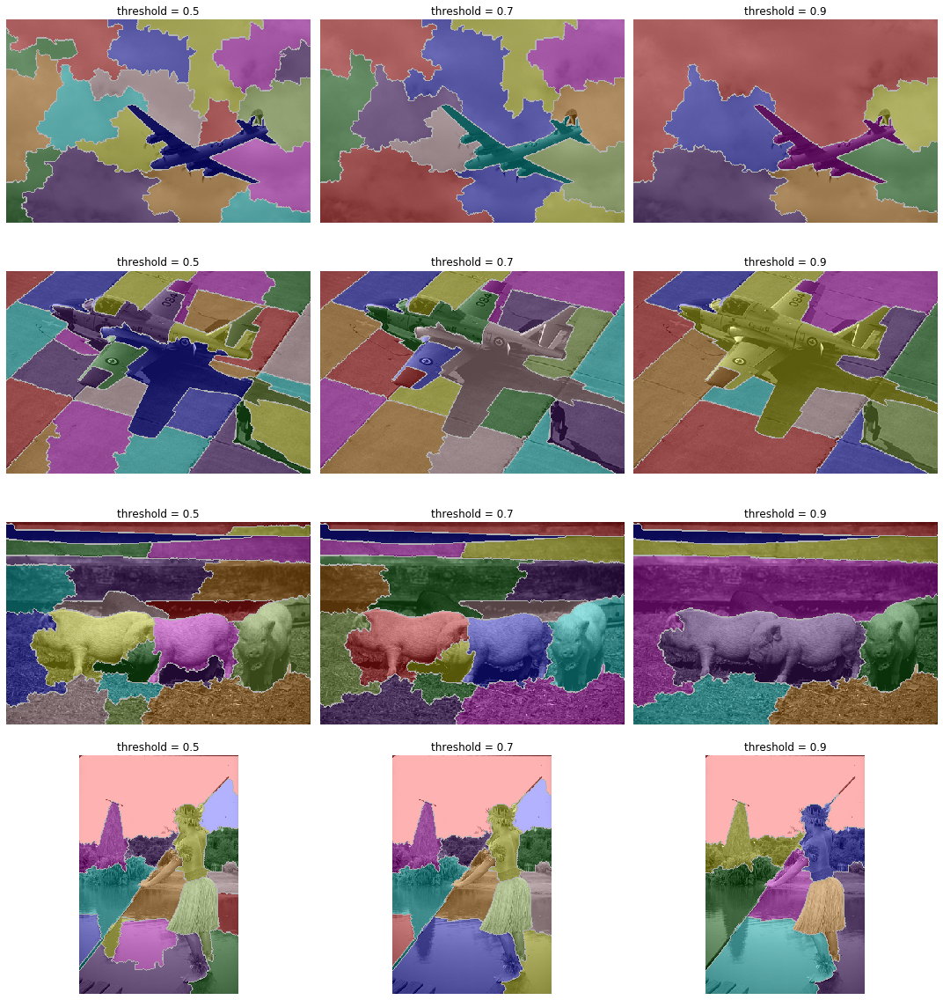

In [78]:
pix_threshold = 100
niter = 100
nseeds = 100

f, axs = plt.subplots(4, 3, figsize=(15, 16))

for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    borders = stochastic_watershed(gradient, niter, nseeds)

    for ii, border_threshold in enumerate([.5, .7, .9]):
        seeds = ndi.label(borders < border_threshold)[0]
        labels = remove_small_areas(seeds, borders, pix_threshold)
        show_segmentation(ax[ii], labels, image)
        ax[ii].set_title("threshold = %.1f" % border_threshold)

for ax in axs.ravel():
    ax.set_axis_off()
f.tight_layout()

#### iii. Full pipeline !
All the methods seen above are wrapped into a single pipeline:
- A weighted morphological gradient in LSH color space is computed
- Stochastic watershed is used to extract border counts from the gradient and get sharp borders
- Compact watershed is used to split the map of border counts into segments uniformly spread over the image
- Hierarchical segmentation is used to merge segments into $K$ segments

This picures are saved as **pipeline_a_Kkk_xxxxHD.png** for the colored segmentation (and **_b_** for borders in red). 

/home/btayart/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:273: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 2. + (arr[idx, 2] - arr[idx, 0]) / delta[idx]


Number of labels:  143
20480 boundary pixels
Edge computing done in 16.5s


/home/btayart/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:269: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = (arr[idx, 1] - arr[idx, 2]) / delta[idx]


Number of labels:  171
21038 boundary pixels
Edge computing done in 17.5s
Number of labels:  138
21694 boundary pixels
Edge computing done in 18.0s


/home/btayart/anaconda3/lib/python3.7/site-packages/skimage/color/colorconv.py:277: RuntimeWarning: divide by zero encountered in true_divide
  out[idx, 0] = 4. + (arr[idx, 0] - arr[idx, 1]) / delta[idx]


Number of labels:  176
21273 boundary pixels
Edge computing done in 17.9s


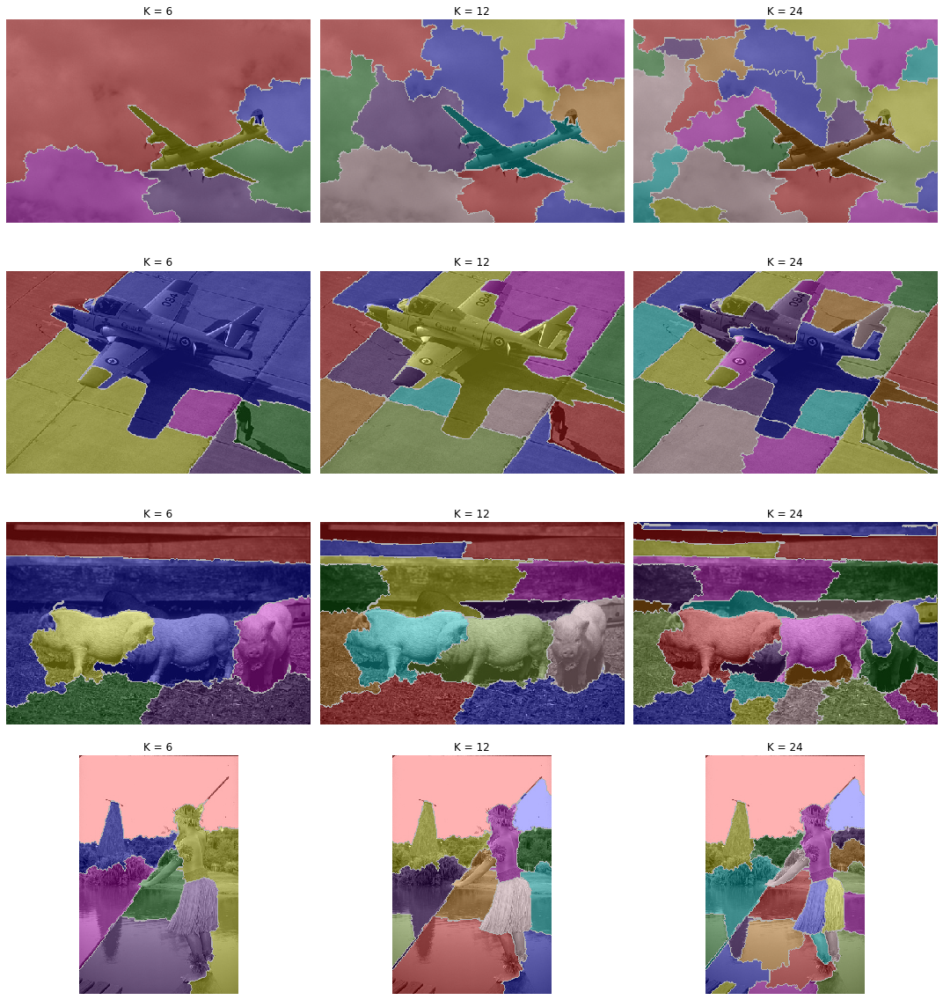

In [79]:
compactness = 0.001
esosion_size = 9
niter = 100
nseeds = 100

f, axs = plt.subplots(4, 3, figsize=(15, 16))

for ax, im in zip(axs, image_files):
    image = io.imread(im)
    gradient = composite_grad(*rgb2lsh(image))

    borders = stochastic_watershed(gradient, niter, nseeds)

    labels = compact_watershed(borders, compactness, esosion_size)

    tree = build_ms_tree(labels, borders)
    for ii, K in enumerate([6, 12, 24]):
        new_labels = segment_tree(labels, tree, K)
        img_save = show_segmentation(ax[ii], new_labels, image)
        ax[ii].set_title("K = %d" % K)

        img_save = (img_save*255).astype(np.uint8)
        seg = segmentation.find_boundaries(new_labels)
        img_save_2 = image.copy()
        img_save_2[seg] = np.array([255, 0, 0], dtype=np.uint8)
        io.imsave("pipeline_a_K%02d_"%K+im, img_save)
        io.imsave("pipeline_b_K%02d_"%K+im, img_save_2)
        
for ax in axs.ravel():
    ax.set_axis_off()
f.tight_layout()

# Conclusion:

It is difficult to find a method that works well on all pictures. The *flying plane* picture is easily over-segmented. Parameter that segment it properly will tend to under-segment more complex pictures such as the *landed plane*. In any case, there is no clearly defined ground-truth. The level of details in the segmentation depends on the purpose for which it is done, and the choice of the method and parameters has do be done with that purpose in mind.